In [1]:
from datasets import load_dataset
import matplotlib.pyplot as plt
import cv2

c:\Users\gbrlg\Desktop\Cours\INF CV\Projet\myenv\Lib\site-packages\tqdm\auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [2]:


import mediapipe as mp
from mediapipe.tasks import python
from mediapipe.tasks.python import vision
from mediapipe.framework.formats import landmark_pb2
import numpy as np

In [3]:
ds = load_dataset("valhalla/emoji-dataset")

In [11]:
print(ds)

DatasetDict({
    train: Dataset({
        features: ['image', 'text'],
        num_rows: 2749
    })
})


In [4]:
# Nombre de lignes et colonnes dans le sous-dataset `train`
train_ds = ds['train']
print("Nombre de lignes :", len(train_ds))
print("Features :", train_ds.column_names)

Nombre de lignes : 2749
Features : ['image', 'text']


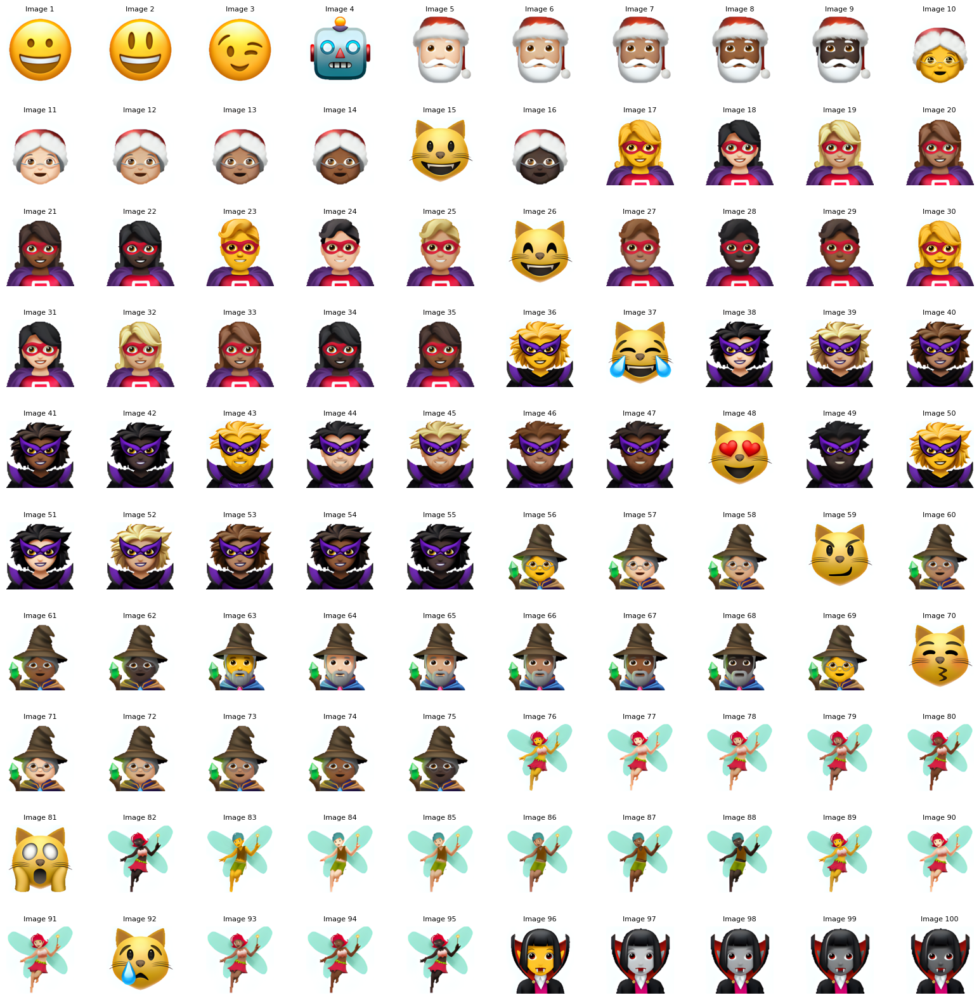

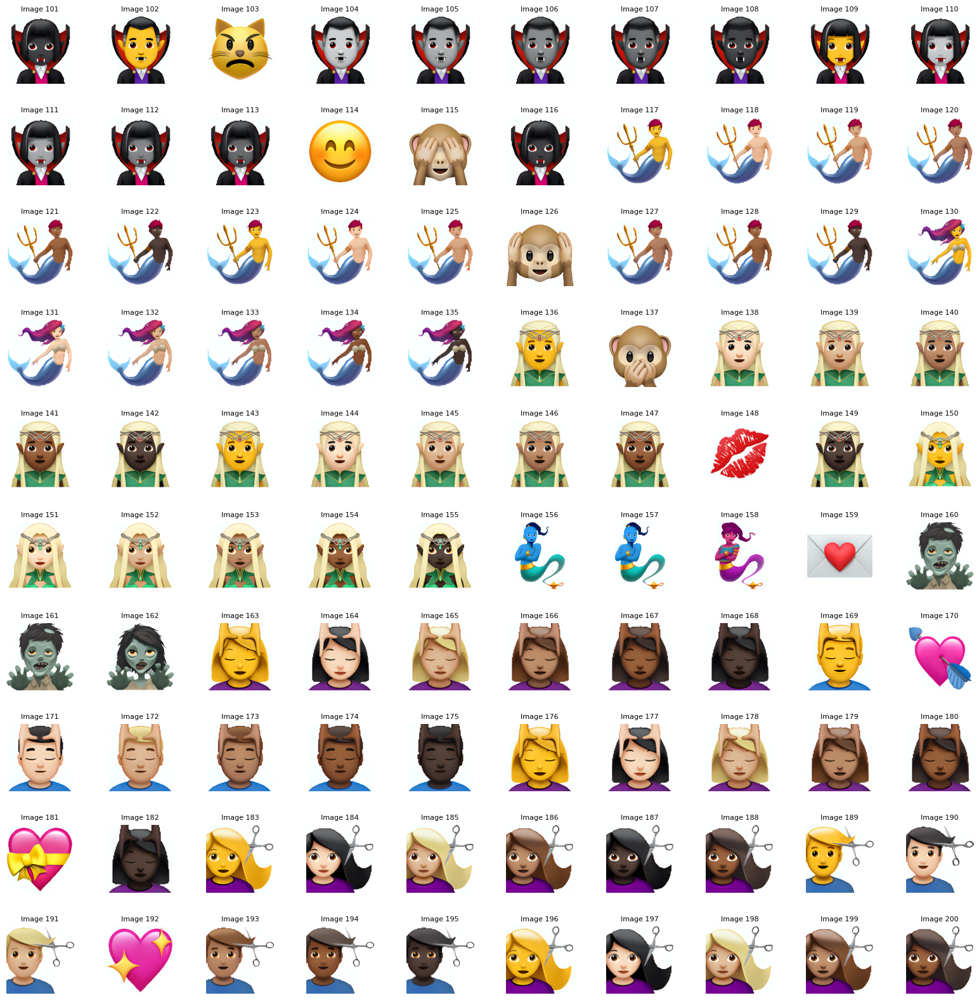

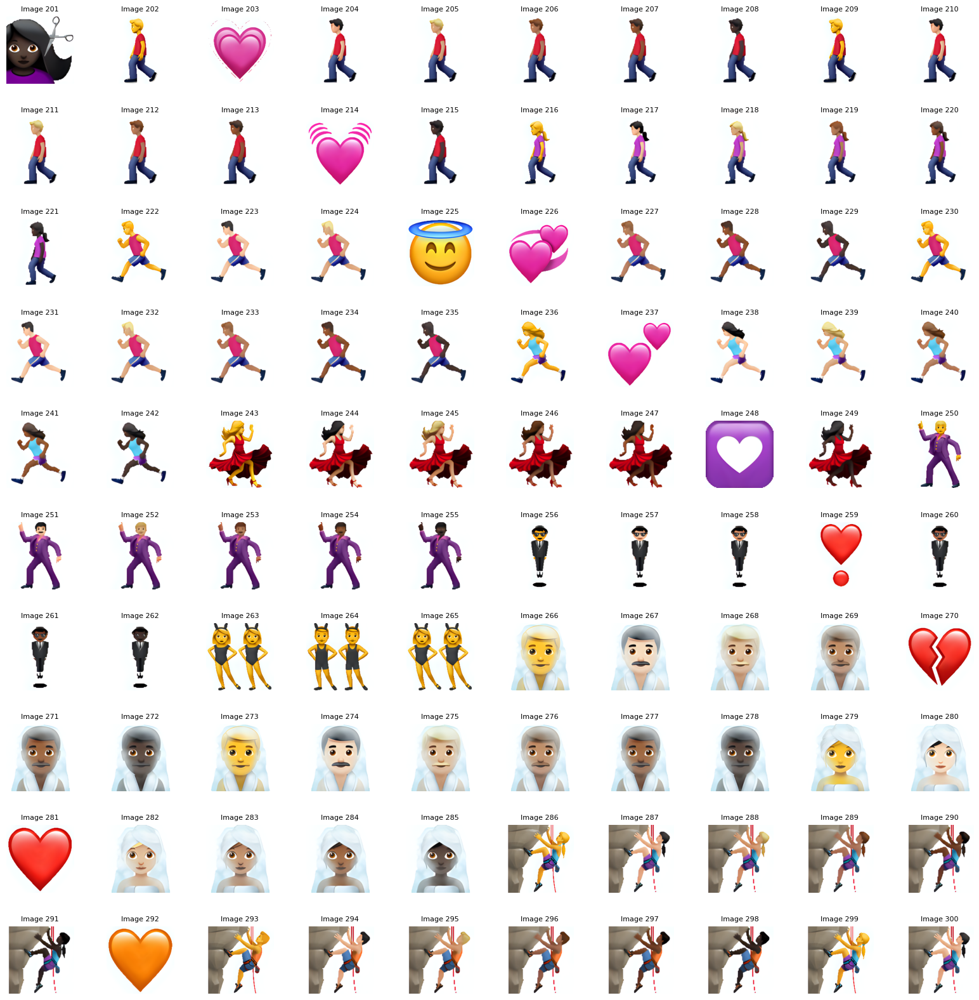

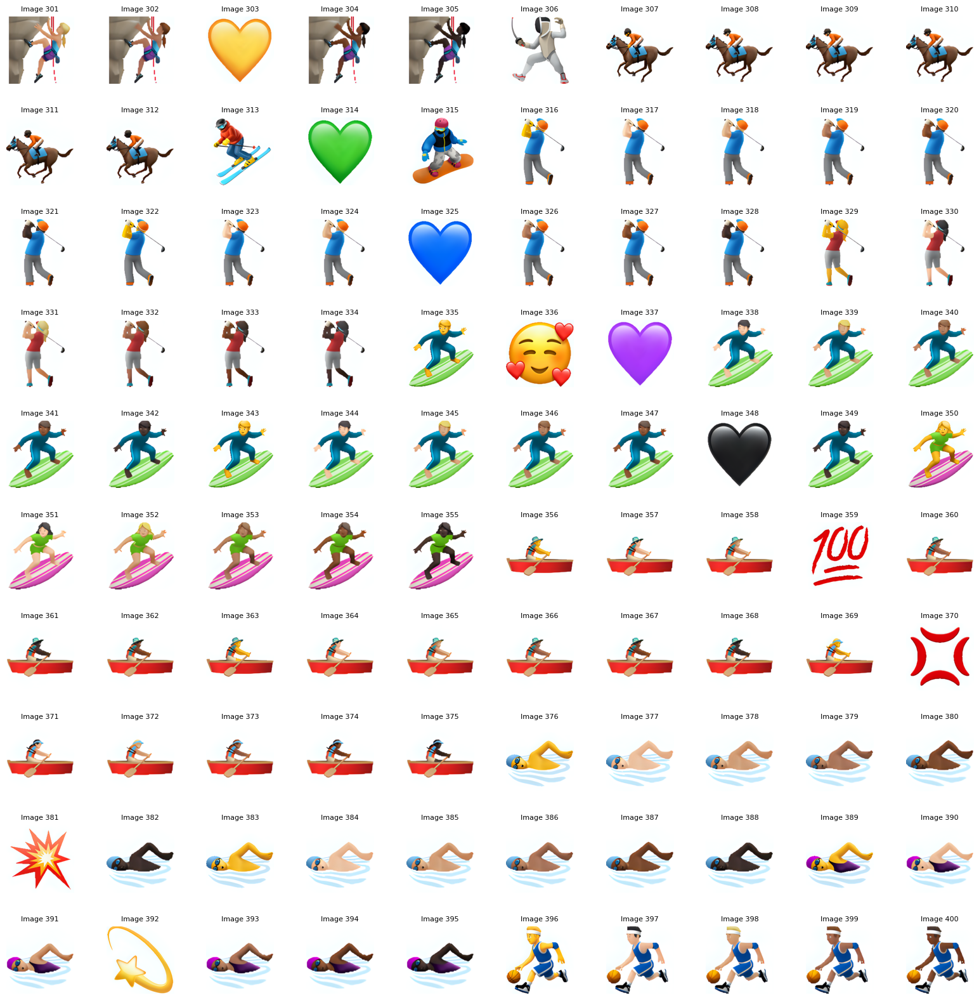

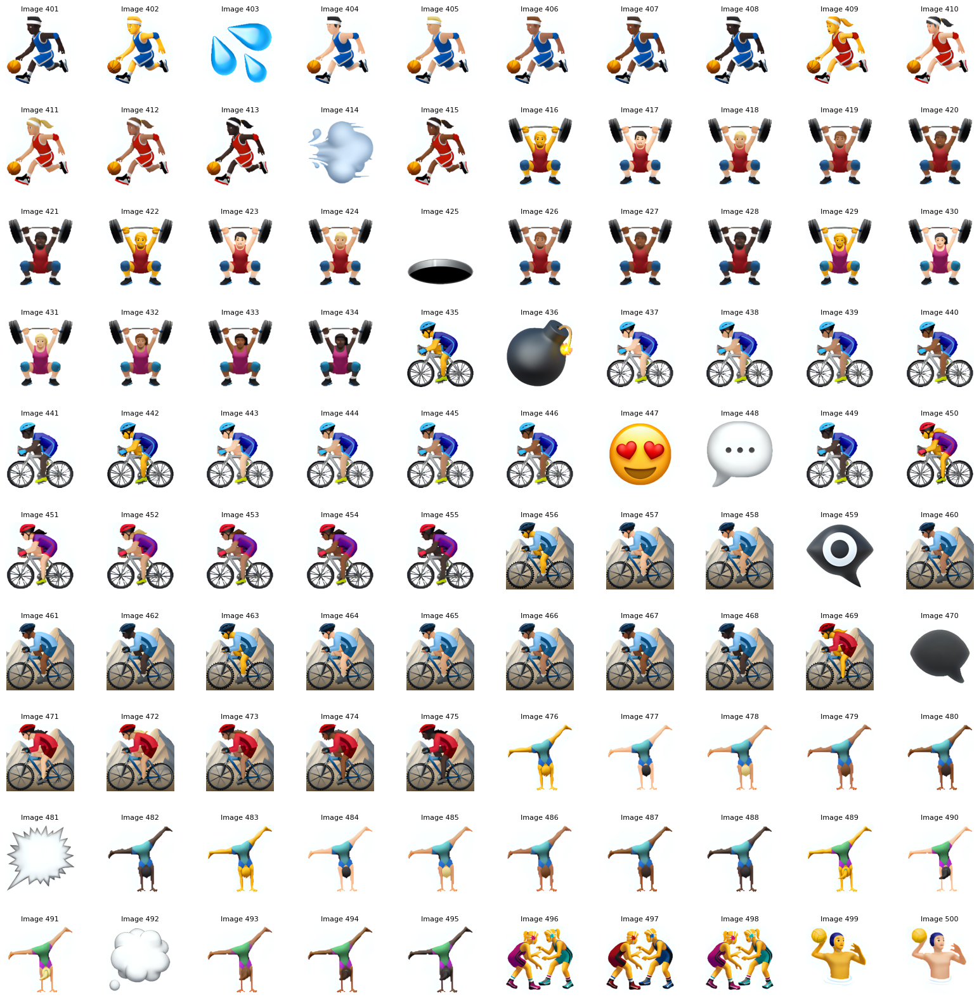

...

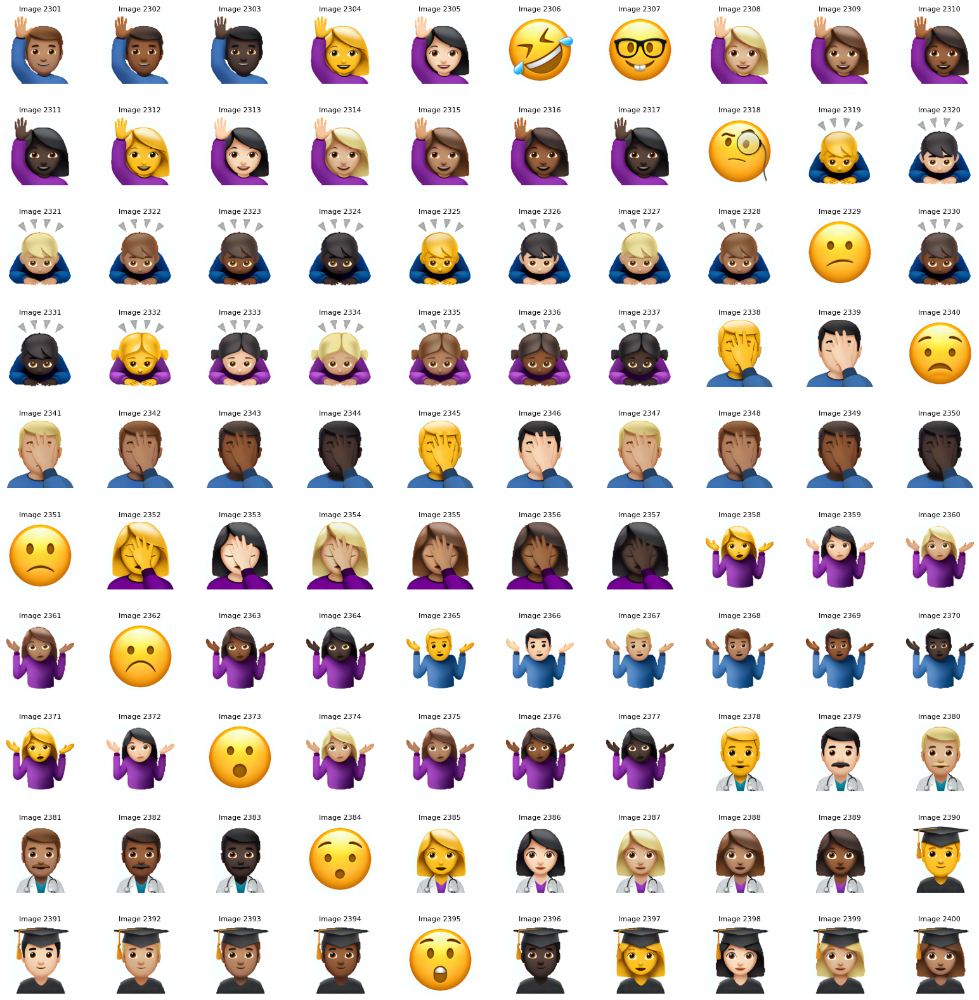

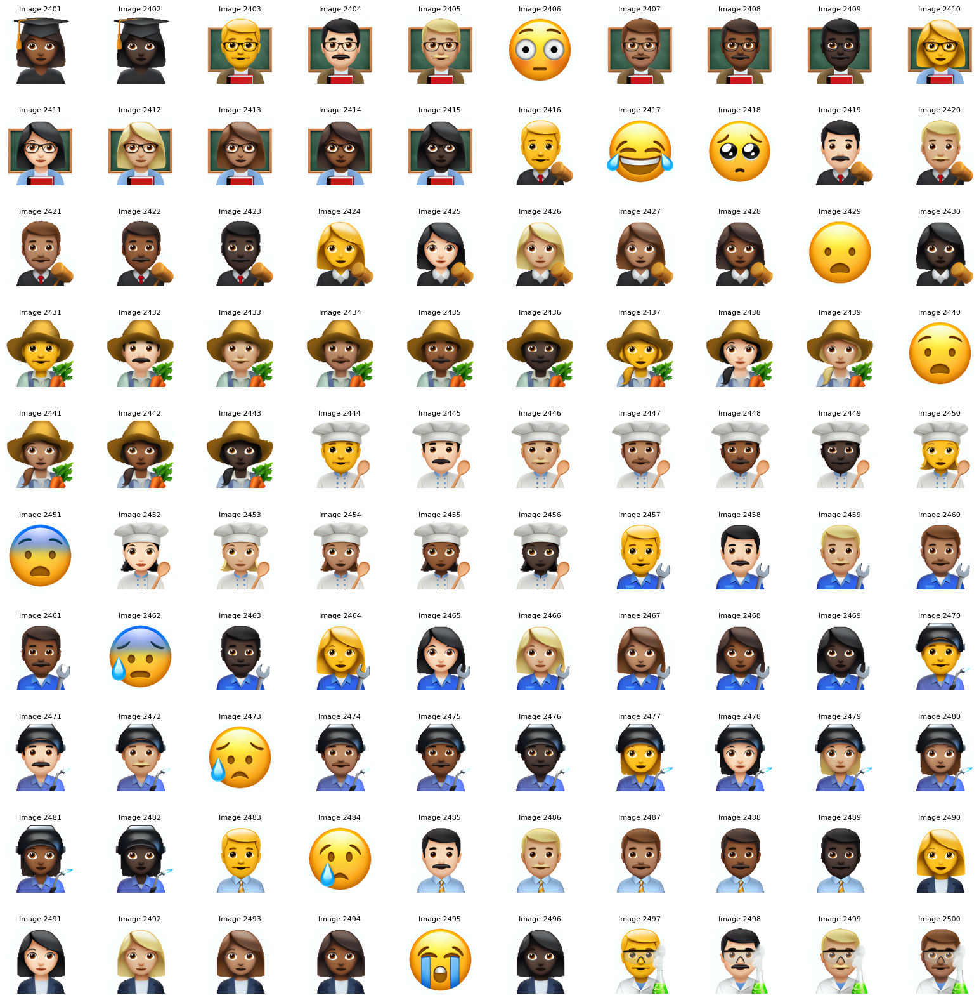

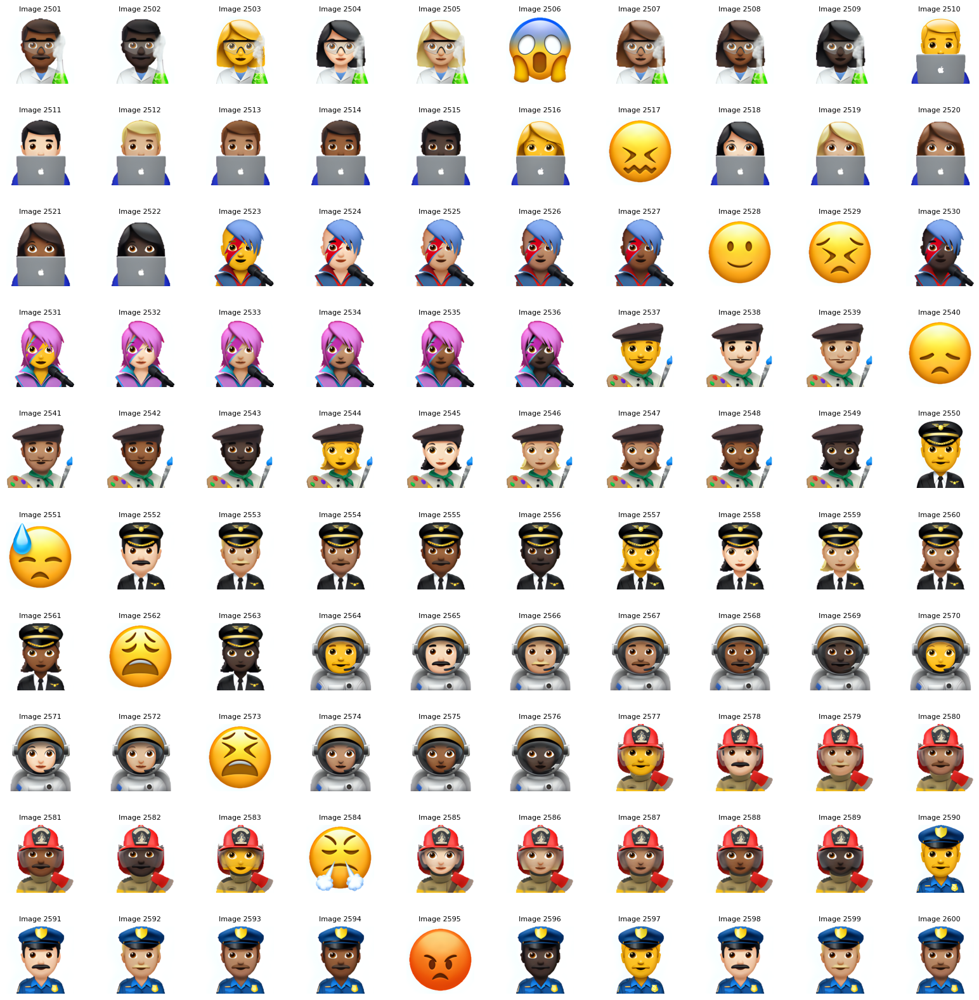

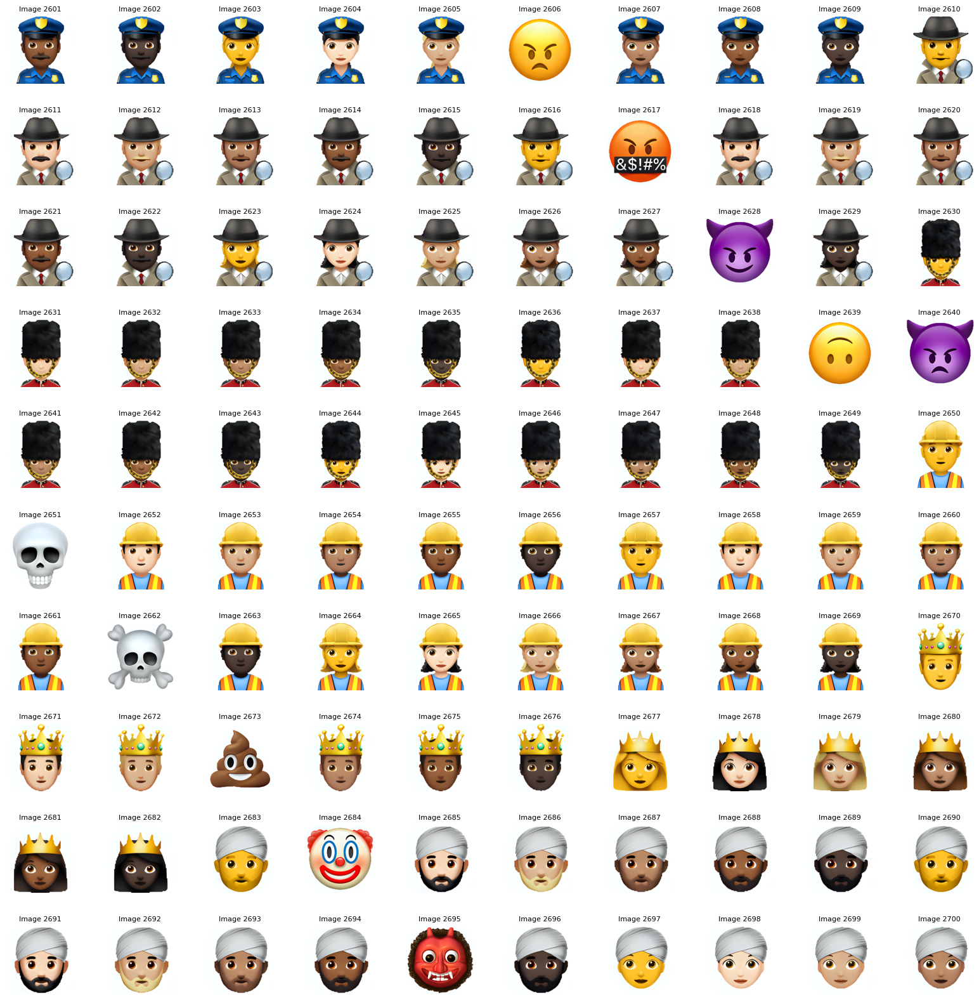

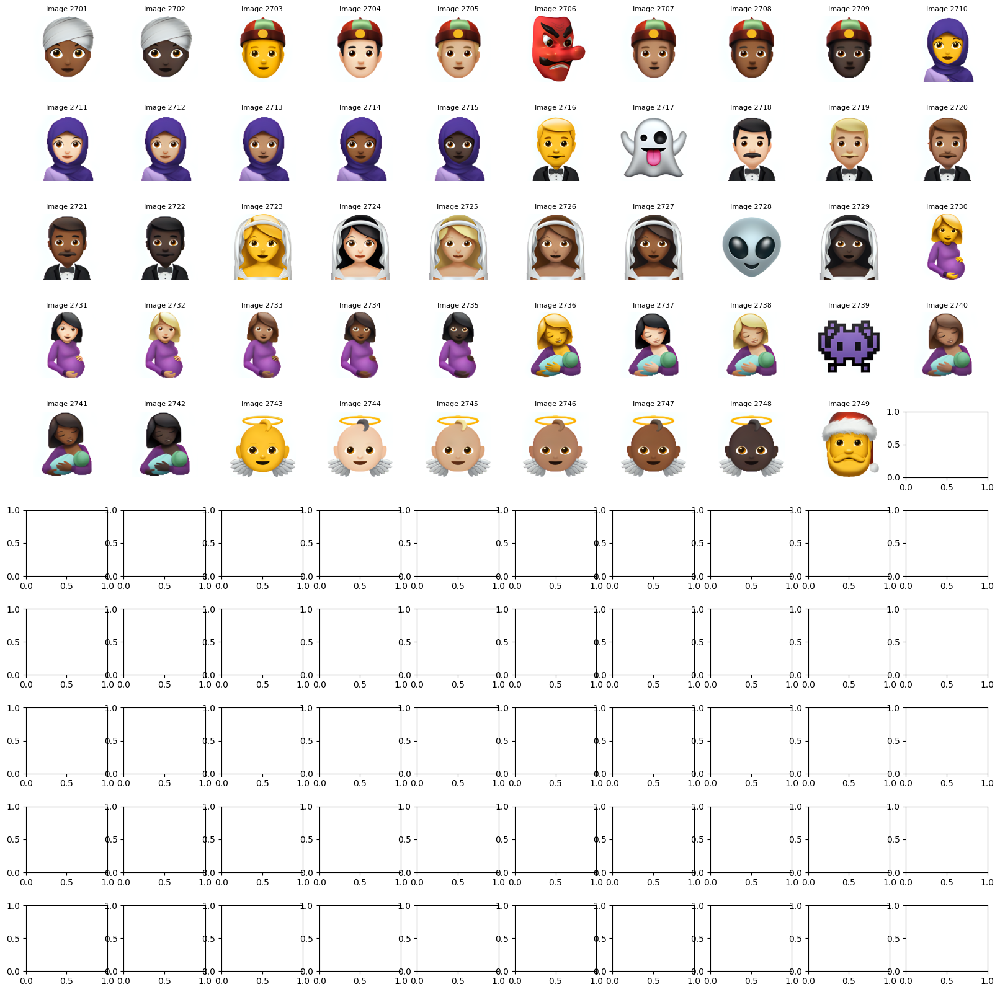

In [11]:
# first_image = ds['train'][0]['image']
# second_image = ds['train'][1]['image']
# far_image = ds['train'][678]['image']

total_images = 2749
# Nombre d'images par lot (ici 100 pour une grille de 10x10)
images_per_batch = 100

for batch_start in range(0, total_images, images_per_batch):
    # Crée une figure avec 10 lignes et 10 colonnes
    fig, axes = plt.subplots(10, 10, figsize=(20, 20))
    fig.subplots_adjust(hspace=0.5)

    # Affiche les images pour le lot actuel
    for i in range(images_per_batch):
        index = batch_start + i
        if index >= total_images:  # Vérifie si on a atteint la fin du dataset
            break

        ax = axes[i // 10, i % 10]
        ax.imshow(ds['train'][index]['image'])
        ax.set_title(f"Image {index + 1}", fontsize=8)
        ax.axis('off')

    plt.show()

Nombre d'images : 24


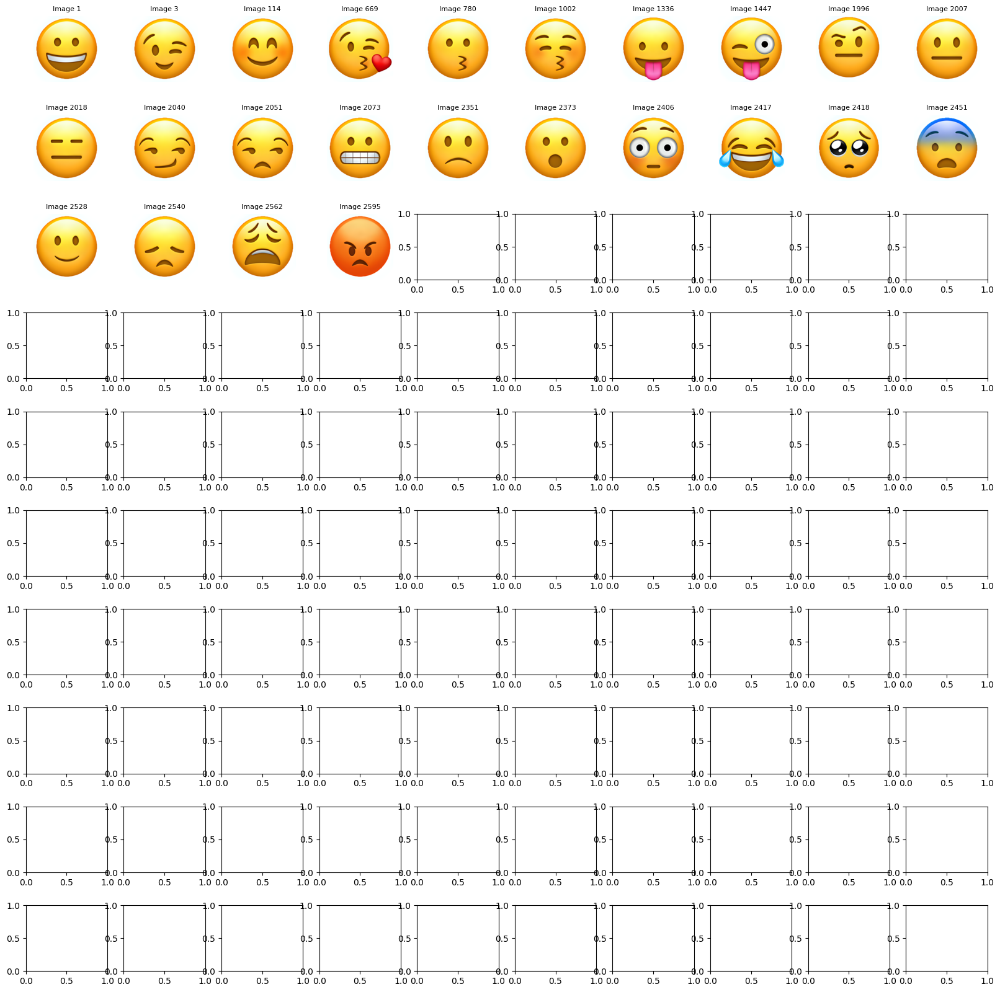

In [68]:

total_images = len(emoji_of_interest)
print("Nombre d'images :", total_images)
images_per_batch = 100

for batch_start in range(0, total_images, images_per_batch):
    fig, axes = plt.subplots(10, 10, figsize=(20, 20))
    fig.subplots_adjust(hspace=0.5)

    for i in range(images_per_batch):
        index = batch_start + i
        if index >= total_images: 
            break

        emoji_index = emoji_of_interest[index]
        ax = axes[i // 10, i % 10]
        ax.imshow(ds['train'][emoji_index]['image'])
        ax.set_title(f"Image {emoji_index + 1}", fontsize=8)
        ax.axis('off')

    plt.show()
    
    emoji_of_interest = [1, 3, 114, 669, 780, 1002, 1336, 1447, 1996, 2007, 2018, 2040, 2051, 2073, 2351, 2373, 2406, 2417, 2418, 2451, 2528, 2540, 2562, 2595]
emoji_of_interest = [i - 1 for i in emoji_of_interest]

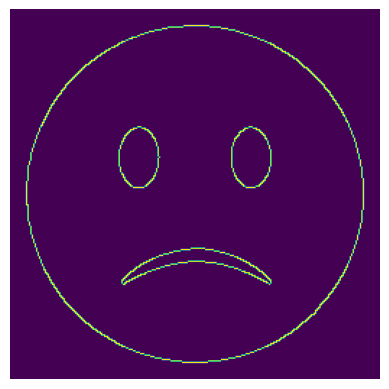

In [ ]:
from functions import compute_edges, image_distance

image = [compute_edges(ds['train'][i]['image']) for i in emoji_of_interest]
text = [ds['train'][i]['text'] for i in emoji_of_interest]
data = [(image[i], text[i]) for i in range(len(emoji_of_interest))]

data_emoji = np.array(data, dtype=object)

j=45
image_3 = data_emoji[j][0]

# Afficher l'image
plt.imshow(image_3)
plt.axis('off')
plt.show()

Differece 1-2 :  23.40939982143925
Differece 1-far :  64.59102104782058
Differece 2-far :  65.20736154760442


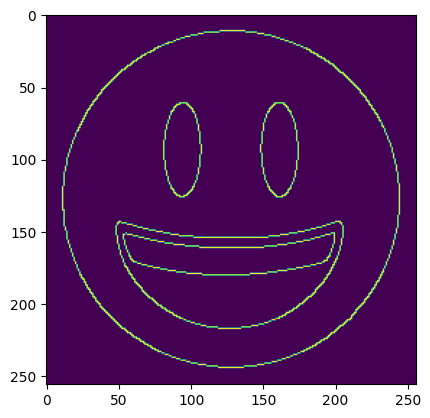

In [45]:
edge_1 = compute_edges(first_image)
edge_2 = compute_edges(second_image)
edge_far = compute_edges(far_image)

diff_1_2 = image_distance(edge_1, edge_2)
diff_1_far = image_distance(edge_1, edge_far)
diff_2_far = image_distance(edge_2, edge_far)

print('Differece 1-2 : ', diff_1_2)
print('Differece 1-far : ', diff_1_far)
print('Differece 2-far : ', diff_2_far)

plt.imshow(edge_1)
plt.imshow(edge_2)